Будем использовать алгоритм VNG(Variable Number of Gradients)

Реализуем вспомогательные функции поиска градиентов и оценки RGB по соседним пикселям

In [1]:
def calculate_grad_green(A, i, j):
    N = abs(A[i + 2, j + 1] - A[i + 2, j + 3]) + \
        abs(A[i + 2, j + 0] - A[i + 2, j + 2]) + \
        abs(A[i + 1, j + 1] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 3, j + 1] - A[i + 3, j + 3]) / 2 + \
        abs(A[i + 1, j + 0] - A[i + 1, j + 2]) / 2 + \
        abs(A[i + 3, j + 0] - A[i + 3, j + 2]) / 2

    S = abs(A[i + 2, j + 1] - A[i + 2, j + 3]) + \
        abs(A[i + 2, j + 4] - A[i + 2, j + 2]) + \
        abs(A[i + 1, j + 1] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 3, j + 1] - A[i + 3, j + 3]) / 2 + \
        abs(A[i + 1, j + 4] - A[i + 1, j + 2]) / 2 + \
        abs(A[i + 3, j + 4] - A[i + 3, j + 2]) / 2

    E = abs(A[i + 3, j + 2] - A[i + 1, j + 2]) + \
        abs(A[i + 4, j + 2] - A[i + 2, j + 2]) + \
        abs(A[i + 3, j + 1] - A[i + 1, j + 1]) / 2 + \
        abs(A[i + 3, j + 3] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 4, j + 1] - A[i + 2, j + 1]) / 2 + \
        abs(A[i + 4, j + 3] - A[i + 2, j + 3]) / 2

    W = abs(A[i + 3, j + 2] - A[i + 1, j + 2]) + \
        abs(A[i + 0, j + 2] - A[i + 2, j + 2]) + \
        abs(A[i + 3, j + 1] - A[i + 1, j + 1]) / 2 + \
        abs(A[i + 3, j + 3] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 0, j + 1] - A[i + 2, j + 1]) / 2 + \
        abs(A[i + 0, j + 3] - A[i + 2, j + 3]) / 2

    NE = abs(A[i + 3, j + 1] - A[i + 1, j + 3]) + \
         abs(A[i + 4, j + 0] - A[i + 2, j + 2]) + \
         abs(A[i + 3, j + 0] - A[i + 1, j + 2]) + \
         abs(A[i + 1, j + 4] - A[i + 3, j + 2])

    SE = abs(A[i + 3, j + 3] - A[i + 1, j + 1]) + \
         abs(A[i + 4, j + 4] - A[i + 2, j + 2]) + \
         abs(A[i + 3, j + 4] - A[i + 1, j + 2]) + \
         abs(A[i + 4, j + 3] - A[i + 2, j + 1])

    NW = abs(A[i + 1, j + 1] - A[i + 3, j + 3]) + \
         abs(A[i + 0, j + 0] - A[i + 2, j + 2]) + \
         abs(A[i + 1, j + 0] - A[i + 3, j + 2]) + \
         abs(A[i + 0, j + 1] - A[i + 2, j + 3])

    SW = abs(A[i + 3, j + 1] - A[i + 1, j + 3]) + \
         abs(A[i + 0, j + 4] - A[i + 2, j + 2]) + \
         abs(A[i + 1, j + 4] - A[i + 3, j + 2]) + \
         abs(A[i + 0, j + 3] - A[i + 2, j + 1])

    return {'N': N, 'E': E, 'S': S, 'W': W, 'NE': NE, 'SE': SE, 'NW': NW, 'SW': SW}


def rgb_calculate_green(A, selected_grad, i, j):
    r_sum, g_sum, b_sum = 0.0, 0.0, 0.0
    for grad in selected_grad:
        if grad == 'S':
            g_sum += (A[i + 2, j + 4] + A[i + 2, j + 2]) / 2
            b_sum += (A[i + 1, j + 2] + A[i + 3, j + 2] + A[i + 1, j + 4] + A[i + 3, j + 4]) / 4
            r_sum += A[i + 2, j + 3]
        elif grad == 'W':
            g_sum += (A[i + 0, j + 2] + A[i + 2, j + 2]) / 2
            b_sum += A[i + 1, j + 2]
            r_sum += (A[i + 0, j + 1] + A[i + 2, j + 1] + A[i + 0, j + 3] + A[i + 2, j + 3]) / 4
        elif grad == 'N':
            g_sum += (A[i + 2, j + 0] + A[i + 2, j + 2]) / 2
            b_sum += (A[i + 1, j + 0] + A[i + 3, j + 0] + A[i + 1, j + 2] + A[i + 3, j + 2]) / 4
            r_sum += A[i + 2, j + 1]
        elif grad == 'E':
            g_sum += (A[i + 4, j + 2] + A[i + 2, j + 2]) / 2
            b_sum += A[i + 3, j + 2]
            r_sum += (A[i + 2, j + 1] + A[i + 4, j + 1] + A[i + 2, j + 3] + A[i + 4, j + 3]) / 4
        elif grad == 'NE':
            g_sum += A[i + 3, j + 1]
            b_sum += (A[i + 3, j + 0] + A[i + 3, j + 2]) / 2
            r_sum += (A[i + 2, j + 1] + A[i + 4, j + 1]) / 2
        elif grad == 'SE':
            g_sum += A[i + 3, j + 3]
            b_sum += (A[i + 3, j + 2] + A[i + 3, j + 4]) / 2
            r_sum += (A[i + 4, j + 3] + A[i + 2, j + 3]) / 2
        elif grad == 'NW':
            g_sum += A[i + 1, j + 1]
            b_sum += (A[i + 1, j + 0] + A[i + 1, j + 2]) / 2
            r_sum += (A[i + 0, j + 1] + A[i + 2, j + 1]) / 2
        elif grad == 'SW':
            g_sum += A[i + 1, j + 3]
            b_sum += (A[i + 1, j + 2] + A[i + 1, j + 4]) / 2
            r_sum += (A[i + 0, j + 3] + A[i + 2, j + 3]) / 2
    b_res = A[i + 2, j + 2] + (b_sum - g_sum) / len(selected_grad)
    r_res = A[i + 2, j + 2] + (r_sum - g_sum) / len(selected_grad)
    return int(r_res), A[i + 2, j + 2], int(b_res)


def calculate_grad_red(A, i, j):
    N = abs(A[i + 2, j + 1] - A[i + 2, j + 3]) + \
        abs(A[i + 2, j + 0] - A[i + 2, j + 2]) + \
        abs(A[i + 1, j + 1] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 3, j + 1] - A[i + 3, j + 3]) / 2 + \
        abs(A[i + 1, j + 0] - A[i + 1, j + 2]) / 2 + \
        abs(A[i + 3, j + 0] - A[i + 3, j + 2]) / 2

    S = abs(A[i + 2, j + 1] - A[i + 2, j + 3]) + \
        abs(A[i + 2, j + 4] - A[i + 2, j + 2]) + \
        abs(A[i + 1, j + 1] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 3, j + 1] - A[i + 3, j + 3]) / 2 + \
        abs(A[i + 1, j + 4] - A[i + 1, j + 2]) / 2 + \
        abs(A[i + 3, j + 4] - A[i + 3, j + 2]) / 2

    E = abs(A[i + 3, j + 2] - A[i + 1, j + 2]) + \
        abs(A[i + 4, j + 2] - A[i + 2, j + 2]) + \
        abs(A[i + 3, j + 1] - A[i + 1, j + 1]) / 2 + \
        abs(A[i + 3, j + 3] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 4, j + 1] - A[i + 2, j + 1]) / 2 + \
        abs(A[i + 4, j + 3] - A[i + 2, j + 3]) / 2

    W = abs(A[i + 3, j + 2] - A[i + 1, j + 2]) + \
        abs(A[i + 0, j + 2] - A[i + 2, j + 2]) + \
        abs(A[i + 3, j + 1] - A[i + 1, j + 1]) / 2 + \
        abs(A[i + 3, j + 3] - A[i + 1, j + 3]) / 2 + \
        abs(A[i + 0, j + 1] - A[i + 2, j + 1]) / 2 + \
        abs(A[i + 0, j + 3] - A[i + 2, j + 3]) / 2

    NE = abs(A[i + 3, j + 1] - A[i + 1, j + 3]) + \
         abs(A[i + 4, j + 0] - A[i + 2, j + 2]) + \
         abs(A[i + 2, j + 1] - A[i + 1, j + 2]) / 2 + \
         abs(A[i + 3, j + 2] - A[i + 2, j + 3]) / 2 + \
         abs(A[i + 3, j + 0] - A[i + 2, j + 1]) / 2 + \
         abs(A[i + 4, j + 1] - A[i + 3, j + 2]) / 2

    SE = abs(A[i + 3, j + 3] - A[i + 1, j + 1]) + \
         abs(A[i + 4, j + 4] - A[i + 2, j + 2]) + \
         abs(A[i + 3, j + 2] - A[i + 2, j + 1]) / 2 + \
         abs(A[i + 2, j + 3] - A[i + 1, j + 2]) / 2 + \
         abs(A[i + 4, j + 3] - A[i + 3, j + 2]) / 2 + \
         abs(A[i + 3, j + 4] - A[i + 2, j + 3]) / 2

    NW = abs(A[i + 1, j + 1] - A[i + 3, j + 3]) + \
         abs(A[i + 0, j + 0] - A[i + 2, j + 2]) + \
         abs(A[i + 2, j + 1] - A[i + 3, j + 2]) / 2 + \
         abs(A[i + 1, j + 2] - A[i + 2, j + 3]) / 2 + \
         abs(A[i + 1, j + 0] - A[i + 2, j + 1]) / 2 + \
         abs(A[i + 0, j + 1] - A[i + 1, j + 2]) / 2

    SW = abs(A[i + 3, j + 1] - A[i + 1, j + 3]) + \
         abs(A[i + 0, j + 4] - A[i + 2, j + 2]) + \
         abs(A[i + 2, j + 1] - A[i + 1, j + 2]) / 2 + \
         abs(A[i + 3, j + 2] - A[i + 2, j + 3]) / 2 + \
         abs(A[i + 0, j + 3] - A[i + 1, j + 2]) / 2 + \
         abs(A[i + 1, j + 4] - A[i + 2, j + 3]) / 2
    return {'N': N, 'E': E, 'S': S, 'W': W, 'NE': NE, 'SE': SE, 'NW': NW, 'SW': SW}


def rgb_calculate_red(A, selected_grad, i, j):
    r_sum, g_sum, b_sum = 0.0, 0.0, 0.0
    for grad in selected_grad:
        if grad == 'S':
            g_sum += A[i + 2, j + 3]
            b_sum += (A[i + 1, j + 3] + A[i + 3, j + 3]) / 2
            r_sum += (A[i + 2, j + 2] + A[i + 2, j + 4]) / 2
        elif grad == 'W':
            g_sum += A[i + 1, j + 2]
            b_sum += (A[i + 1, j + 1] + A[i + 1, j + 3]) / 2
            r_sum += (A[i + 0, j + 2] + A[i + 2, j + 2]) / 2
        elif grad == 'N':
            g_sum += A[i + 2, j + 1]
            b_sum += (A[i + 1, j + 1] + A[i + 3, j + 1]) / 2
            r_sum += (A[i + 2, j + 2] + A[i + 2, j + 0]) / 2
        elif grad == 'E':
            g_sum += A[i + 3, j + 2]
            b_sum += (A[i + 3, j + 1] + A[i + 3, j + 3]) / 2
            r_sum += (A[i + 4, j + 2] + A[i + 2, j + 2]) / 2
        elif grad == 'NE':
            g_sum += (A[i + 3, j + 0] + A[i + 2, j + 1] + A[i + 4, j + 1] + A[i + 3, j + 2]) / 4
            b_sum += A[i + 3, j + 1]
            r_sum += (A[i + 2, j + 2] + A[i + 4, j + 0]) / 2
        elif grad == 'SE':
            g_sum += (A[i + 3, j + 2] + A[i + 4, j + 3] + A[i + 2, j + 3] + A[i + 3, j + 4]) / 4
            b_sum += A[i + 3, j + 3]
            r_sum += (A[i + 2, j + 2] + A[i + 4, j + 4]) / 2
        elif grad == 'NW':
            g_sum += (A[i + 1, j + 0] + A[i + 0, j + 1] + A[i + 2, j + 1] + A[i + 1, j + 2]) / 4
            b_sum += A[i + 1, j + 1]
            r_sum += (A[i + 2, j + 2] + A[i + 0, j + 0]) / 2
        elif grad == 'SW':
            g_sum += (A[i + 1, j + 2] + A[i + 0, j + 3] + A[i + 2, j + 3] + A[i + 1, j + 4]) / 4
            b_sum += A[i + 1, j + 3]
            r_sum += (A[i + 2, j + 2] + A[i + 0, j + 4]) / 2
    b_res = A[i + 2, j + 2] + (b_sum - r_sum) / len(selected_grad)
    g_res = A[i + 2, j + 2] + (g_sum - r_sum) / len(selected_grad)
    return A[i + 2, j + 2], int(g_res), int(b_res)

Теперь сам VNG

In [2]:
from itertools import product
from time import time

from tqdm import tqdm
from PIL import Image, ImageDraw

In [5]:
def VNG(image):
    width, height = image.size
    pix = image.load()
    result = Image.new('RGB', (width, height), 'white')
    idraw = ImageDraw.Draw(result)

    k1 = 1.5
    k2 = 0.5

    start = time()
    for i, j in tqdm(product(range(width - 4), range(height - 4))):
        pixel_coord = (i + 2, j + 2)

        if (i + j) % 2 == 0:
            grad = calculate_grad_red(pix, i, j)
        else:
            grad = calculate_grad_green(pix, i, j)

        T = k1 * min(grad.values()) + k2 * (max(grad.values()) - min(grad.values()))
        selected_grad = {key: value for key, value in grad.items() if value <= T}

        if i % 2 == 0 and j % 2 == 0:
            r, g, b = rgb_calculate_red(pix, selected_grad, i, j)
        elif i % 2 == 0 and j % 2 == 1:
            r, g, b = rgb_calculate_green(pix, selected_grad, i, j)
        elif i % 2 == 1 and j % 2 == 0:
            b, g, r = rgb_calculate_green(pix, selected_grad, i, j)
        elif i % 2 == 1 and j % 2 == 1:
            b, g, r = rgb_calculate_red(pix, selected_grad, i, j)

        idraw.point(pixel_coord, (r, g, b))
    end = time()
    del idraw
    return result, (end - start) / (width - 4) / (height - 4)

In [7]:
halftone = Image.open("CFA.bmp")
original = Image.open("Original.bmp")
result, time_per_pixel = VNG(halftone)

8631868it [03:55, 36689.75it/s]


In [28]:
print(f'{time_per_pixel * 1000000} microseconds per pixel')

27.25578821390734 microseconds per pixel


Давайте теперь посмотрим на PSNR

In [29]:
from math import log10

In [32]:
def PSNR(lhs, rhs):
    def Y_calc(r, g, b):
        return 0.299 * r + 0.587 * g + 0.114 * b
    
    pix_lhs = lhs.load()
    pix_rhs = rhs.load()
    
    acc = 0
    for i in range(2, lhs.size[0] - 2):
        for j in range(2, lhs.size[1] - 2):
            acc += (Y_calc(*pix_lhs[i, j]) - Y_calc(*pix_rhs[i,j])) ** 2
    mse = acc / lhs.size[0] / lhs.size[1]
    return 10 * log10(255 ** 2 / mse)

In [34]:
print(f'PSNR для оригинала и восттановленного изображения: {PSNR(original, result)}')

PSNR для оригинала и восттановленного изображения: 1.099107513013424


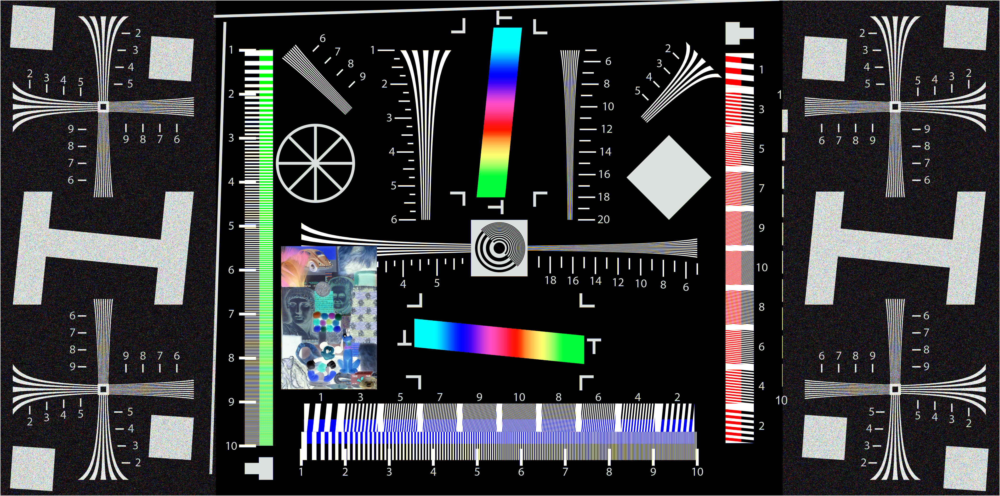

In [35]:
result

Теперь хочется добавить негатив для сходства с оригиналом

In [40]:
def apply_negative(image):
    result = image.copy()
    pix = result.load()
    idraw = ImageDraw.Draw(result)
    for i in range(result.size[0]):
        for j in range(result.size[1]):
            idraw.point((i, j), (255 - pix[i,j][0], 255 - pix[i,j][1], 255 - pix[i,j][2]))
    del idraw
    return result

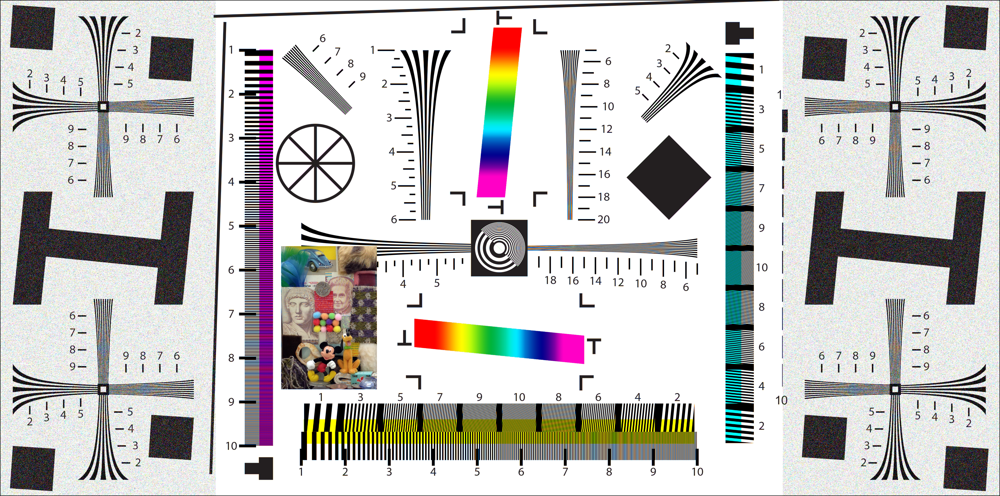

In [41]:
negative = apply_negative(result)
negative

Теперь стало прям очень похоже на оригинал

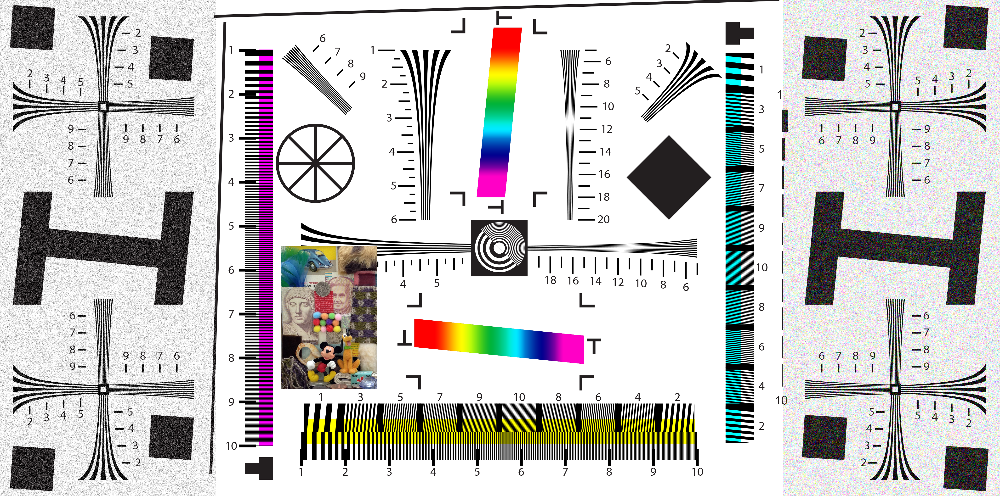

In [42]:
original

Теперь рассчитаем оценку снижения разрешения

Так как мы не посчитали по 2 пикселя с краев, то мы должны кропнуть карнинку

In [44]:
result_cropped = result.crop((2, 2, result.size[0] - 2, result.size[1] - 2))
print(f'Оценка снижения разрешения: {original.size[0] * original.size[1] / result_cropped.size[0] / result_cropped.size[1]}')

Оценка снижения разрешения: 1.002893927478965
